<a href="https://colab.research.google.com/github/Adam129511/sieci2/blob/main/dyski.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Image Preprocessing - przygotowoanie obrazów
**Augmentacja danych** - technika pozwalająca na zwiększenie zbioru treningowego przez odpowiednie przekształcenia danych wejsciowych. Technika bardzo przydtna zwłaszcza gdy nie mamy wystarczającej ilości danych do wytrenowania sieci. W uczeniu głębokim im więcej posiadamy danych treningowych tym teoretycznie lepiej jesteśmy w stanie wytrenować sieć. Wykorzystamy tą technikę do trenowania problemów związanych z przetwarzaniem obrazu.

Biblioteka Keras dostarcza narzędzia do augmentacji danych, które działają automatycznie podczas trenowania sieci. Możemy to zrobić dzięki klasie ImageDataGenerator.

In [5]:

%tensorflow_version 2.x
import matplotlib.pyplot as plt
from numpy import expand_dims

from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import ImageDataGenerator

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


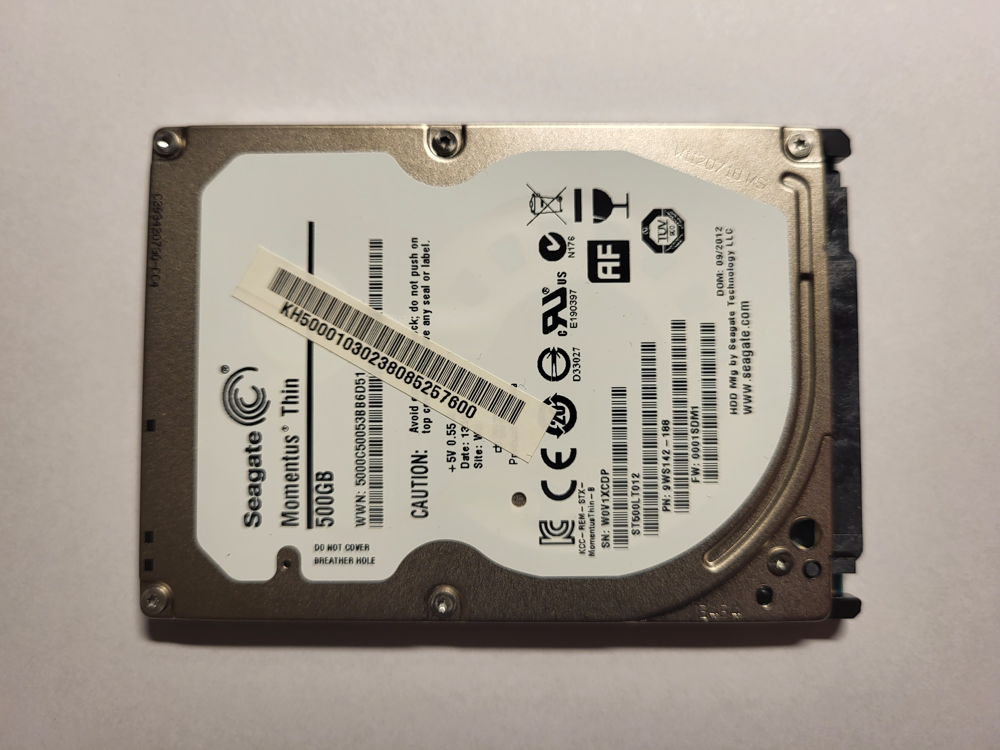

In [7]:
#Ładujemy zdjęcie
img = load_img('dysk1.jpg')
img

In [8]:
data = img_to_array(img)#konwersja obrazu na tablice
data.shape#wyswietlenie rozmiaru zdjęcia

(3000, 4000, 3)

In [9]:
data[:,:,0]

array([[192., 193., 195., ..., 212., 214., 213.],
       [194., 193., 194., ..., 213., 214., 213.],
       [194., 192., 193., ..., 212., 214., 212.],
       ...,
       [150., 151., 149., ..., 151., 150., 149.],
       [151., 152., 152., ..., 149., 149., 152.],
       [151., 148., 150., ..., 147., 146., 150.]], dtype=float32)

In [13]:
data[:,:,1]

array([[179., 180., 182., ..., 199., 200., 199.],
       [181., 180., 181., ..., 200., 200., 199.],
       [181., 179., 180., ..., 199., 200., 198.],
       ...,
       [137., 138., 136., ..., 138., 137., 136.],
       [138., 139., 139., ..., 136., 136., 139.],
       [138., 135., 137., ..., 134., 133., 137.]], dtype=float32)

In [15]:
data[:,:,2]

array([[173., 174., 176., ..., 193., 197., 196.],
       [175., 174., 175., ..., 194., 197., 196.],
       [175., 173., 174., ..., 193., 197., 195.],
       ...,
       [129., 130., 128., ..., 129., 129., 128.],
       [130., 131., 131., ..., 128., 130., 133.],
       [130., 127., 129., ..., 126., 127., 131.]], dtype=float32)

In [17]:
samples = expand_dims(data, 0)#ZWIEKSZA WYMIAR
samples

array([[[[192., 179., 173.],
         [193., 180., 174.],
         [195., 182., 176.],
         ...,
         [212., 199., 193.],
         [214., 200., 197.],
         [213., 199., 196.]],

        [[194., 181., 175.],
         [193., 180., 174.],
         [194., 181., 175.],
         ...,
         [213., 200., 194.],
         [214., 200., 197.],
         [213., 199., 196.]],

        [[194., 181., 175.],
         [192., 179., 173.],
         [193., 180., 174.],
         ...,
         [212., 199., 193.],
         [214., 200., 197.],
         [212., 198., 195.]],

        ...,

        [[150., 137., 129.],
         [151., 138., 130.],
         [149., 136., 128.],
         ...,
         [151., 138., 129.],
         [150., 137., 129.],
         [149., 136., 128.]],

        [[151., 138., 130.],
         [152., 139., 131.],
         [152., 139., 131.],
         ...,
         [149., 136., 128.],
         [149., 136., 130.],
         [152., 139., 133.]],

        [[151., 138., 130.],
       

In [19]:
samples.shape #tensor 5

(1, 3000, 4000, 3)

1 wartośc oznacza liczbę zdjęć
pozostałe to atrybuty naszego zdjęcia


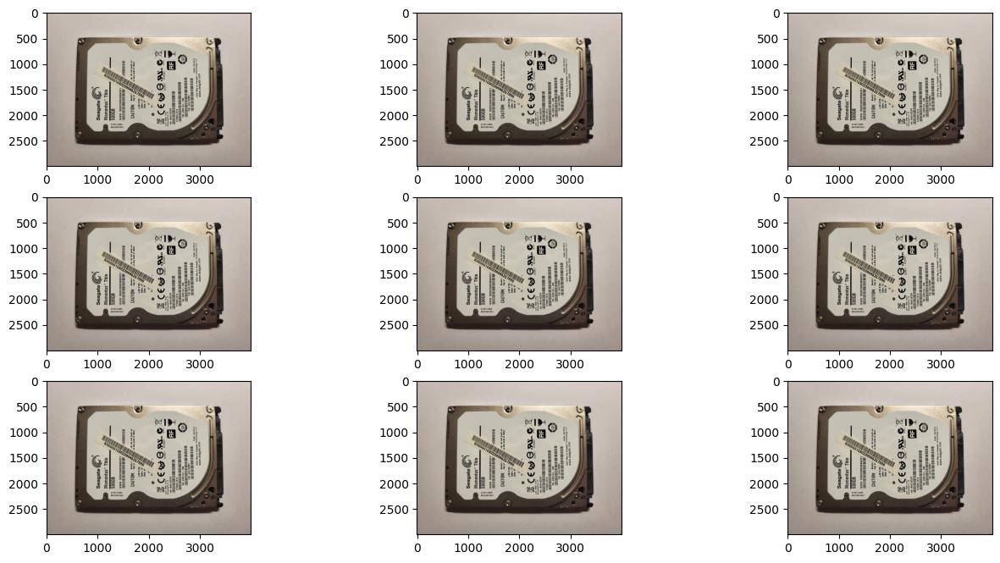

In [20]:

datagen = ImageDataGenerator() #Podczas trenowania modelu, funkcja tworzy dane  w "locie" które nie są zapisywae na dysku

iterator = datagen.flow(samples, batch_size=1) #iterator pomagający generować próbki w locie

plt.figure(figsize=(16, 8))
for i in range(9):
    plt.subplot(330 + i + 1)
    batch = iterator.next()
    image = batch[0].astype('uint8')
    plt.imshow(image)
plt.show()


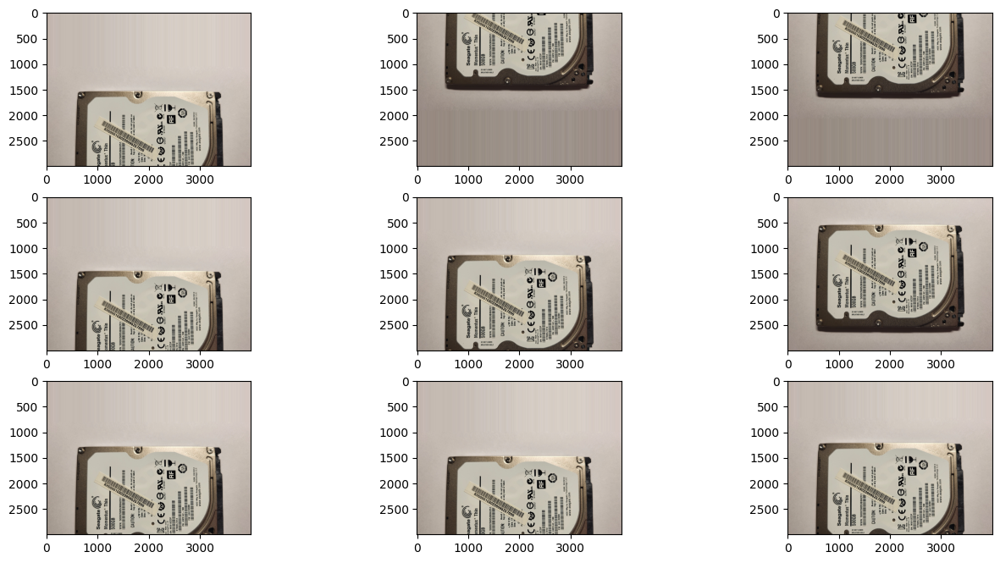

In [24]:

datagen = ImageDataGenerator(width_shift_range = 0.3) #zdjęcie przesuwane o maksymalnie 30%szerokości zdjęcia

iterator = datagen.flow(samples, batch_size=1) #iterator pomagający generować próbki w locie

plt.figure(figsize=(16, 8))
for i in range(9):
    plt.subplot(330 + i + 1)
    batch = iterator.next()
    image = batch[0].astype('uint8')
    plt.imshow(image)
plt.show()

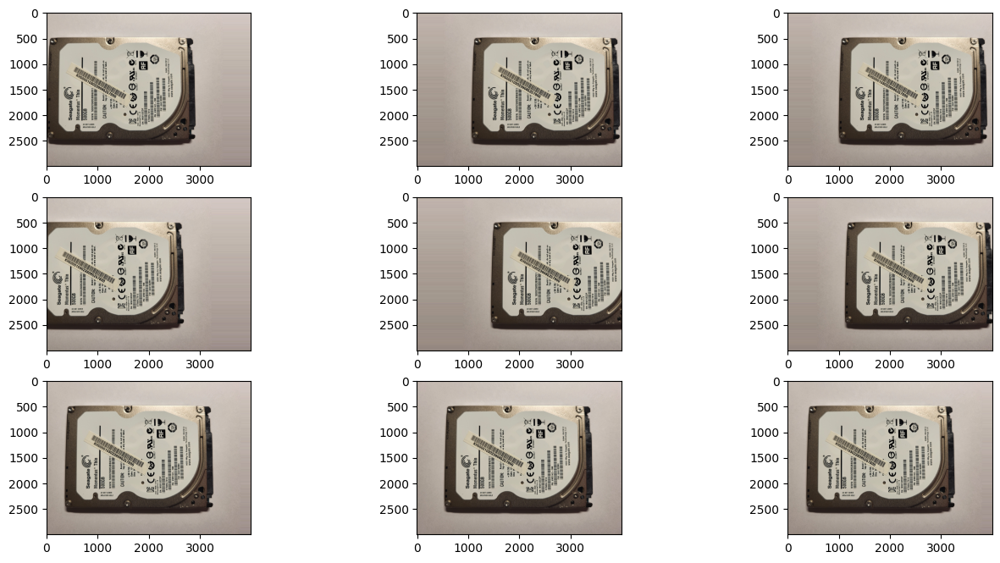

In [25]:

datagen = ImageDataGenerator(height_shift_range = 0.3) #zdjęcie przesuwane o maksymalnie 20%szerokości zdjęcia

iterator = datagen.flow(samples, batch_size=1) #iterator pomagający generować próbki w locie

plt.figure(figsize=(16, 8))
for i in range(9):
    plt.subplot(330 + i + 1)
    batch = iterator.next()
    image = batch[0].astype('uint8')
    plt.imshow(image)
plt.show()

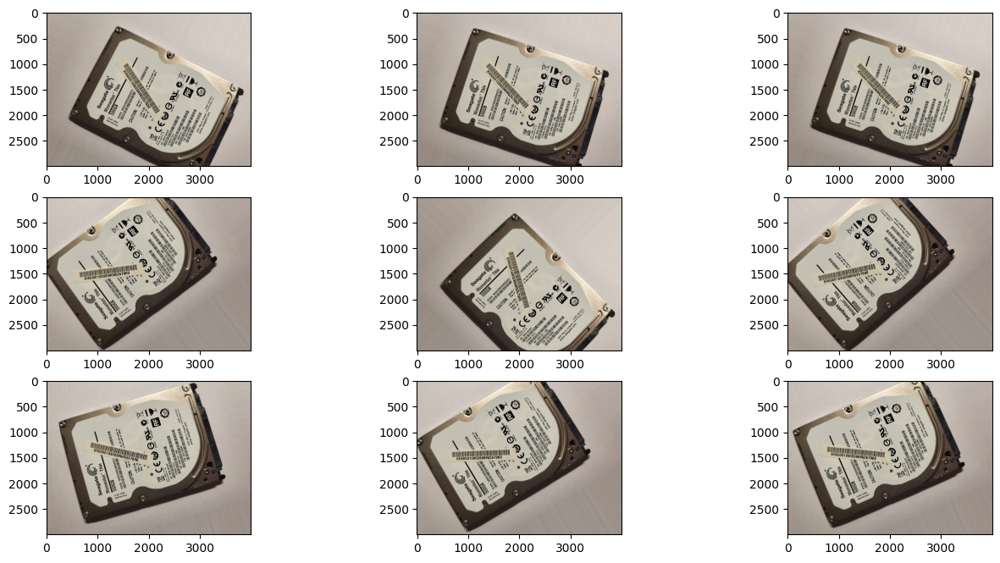

In [26]:


datagen = ImageDataGenerator(rotation_range=45)

iterator = datagen.flow(samples, batch_size=1)

plt.figure(figsize=(16, 8))
for i in range(9):
    plt.subplot(330 + i + 1)
    batch = iterator.next()
    image = batch[0].astype('uint8')
    plt.imshow(image)
plt.show()

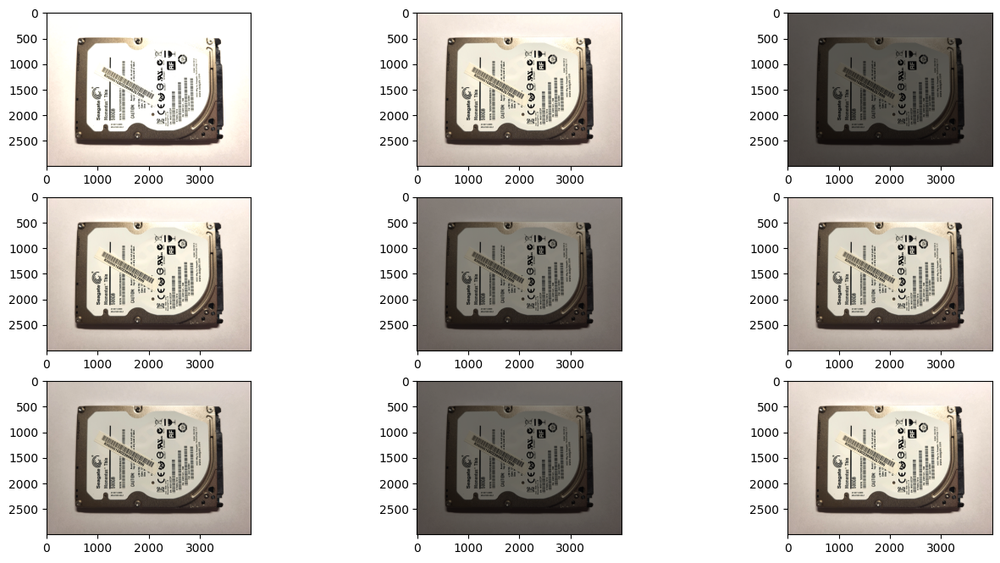

In [27]:

datagen = ImageDataGenerator(brightness_range=[0.4, 1.5]) #jasność

iterator = datagen.flow(samples, batch_size=1)

plt.figure(figsize=(16, 8))
for i in range(9):
    plt.subplot(330 + i + 1)
    batch = iterator.next()
    image = batch[0].astype('uint8')
    plt.imshow(image)
plt.show()

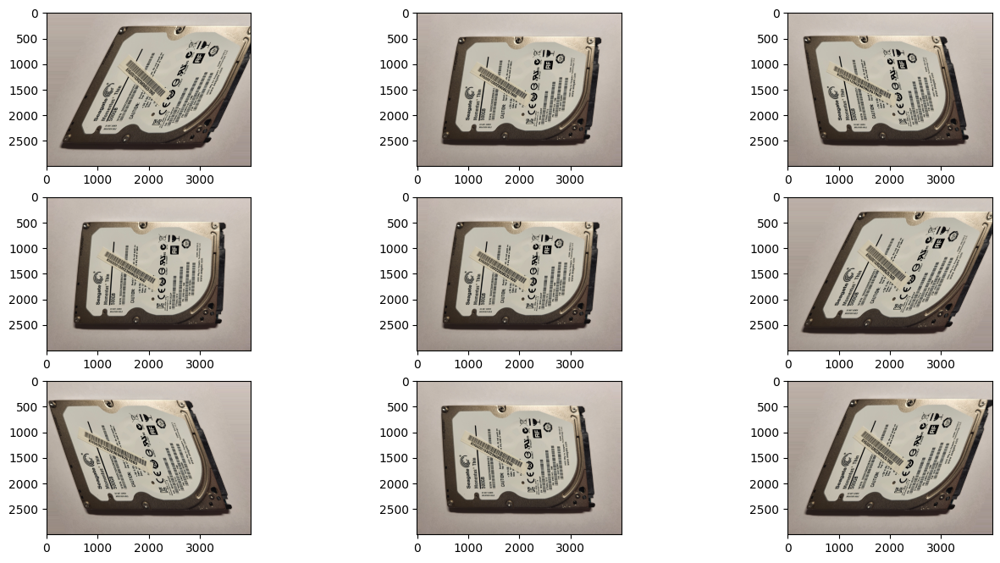

In [28]:
datagen = ImageDataGenerator(shear_range=30)#zmiana perspektywy


iterator = datagen.flow(samples, batch_size=1)

plt.figure(figsize=(16, 8))
for i in range(9):
    plt.subplot(330 + i + 1)
    batch = iterator.next()
    image = batch[0].astype('uint8')
    plt.imshow(image)
plt.show()


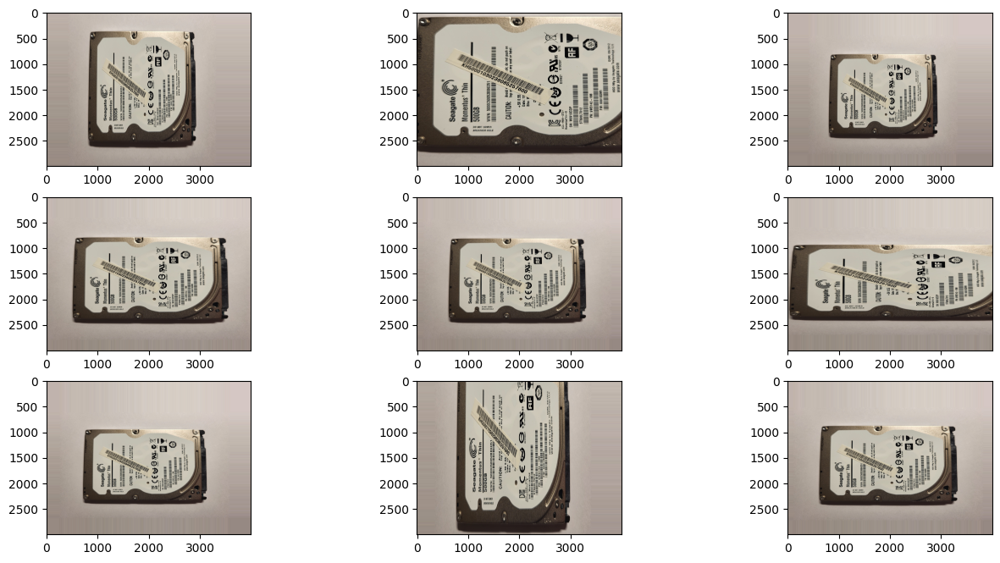

In [29]:

datagen = ImageDataGenerator(zoom_range=0.5)#przyblizenie i oddalenie zdjecia

iterator = datagen.flow(samples, batch_size=1)

plt.figure(figsize=(16, 8))
for i in range(9):
    plt.subplot(330 + i + 1)
    batch = iterator.next()
    image = batch[0].astype('uint8')
    plt.imshow(image)
plt.show()

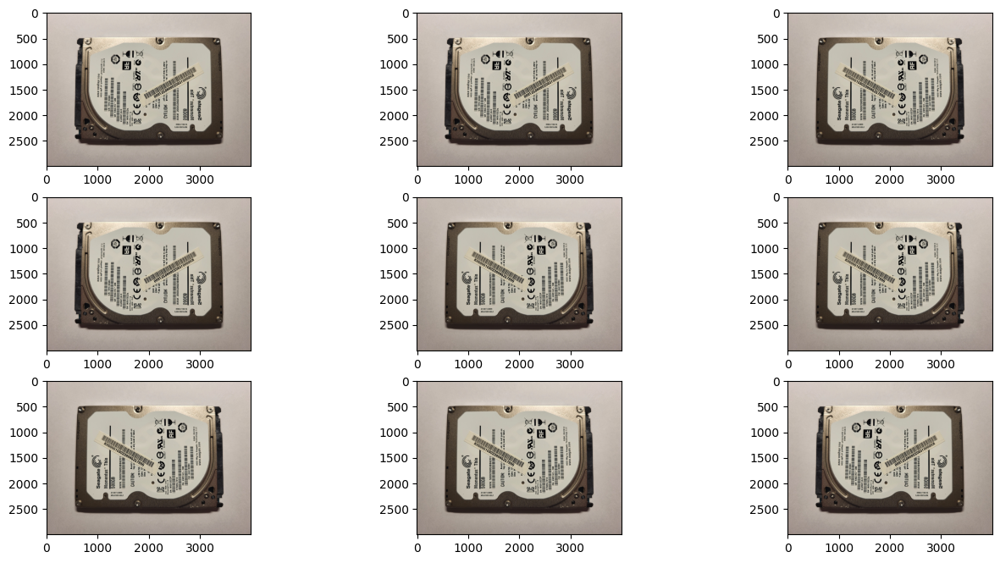

In [30]:
datagen = ImageDataGenerator(horizontal_flip=True)#obrócenie horyzontalne

iterator = datagen.flow(samples, batch_size=1)

plt.figure(figsize=(16, 8))
for i in range(9):
    plt.subplot(330 + i + 1)
    batch = iterator.next()
    image = batch[0].astype('uint8')
    plt.imshow(image)
plt.show()

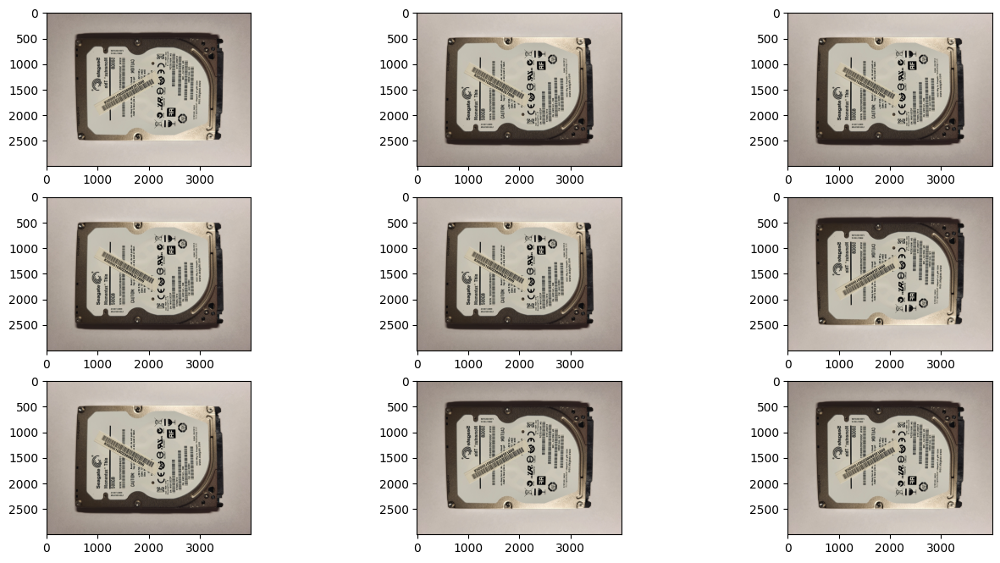

In [31]:

datagen = ImageDataGenerator(vertical_flip=True)#obrócenie w pionie

iterator = datagen.flow(samples, batch_size=1)

plt.figure(figsize=(16, 8))
for i in range(9):
    plt.subplot(330 + i + 1)
    batch = iterator.next()
    image = batch[0].astype('uint8')
    plt.imshow(image)
plt.show()

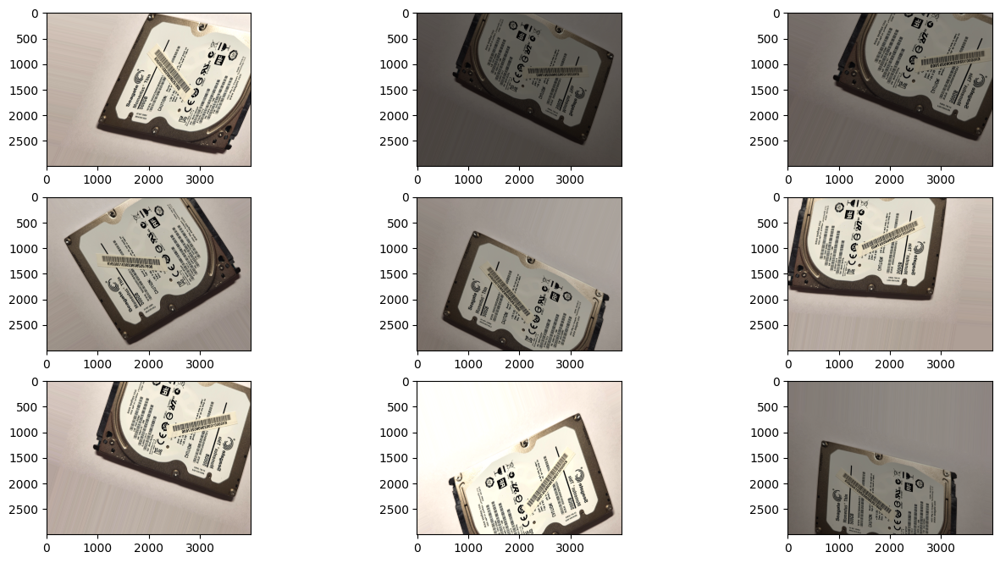

In [32]:

datagen = ImageDataGenerator(width_shift_range=0.2,
                             height_shift_range=0.2,
                             rotation_range=30,
                             brightness_range=[0.4, 1.5],
                             shear_range=20,
                             zoom_range=0.1,
                             horizontal_flip=True)

iterator = datagen.flow(samples, batch_size=1)

plt.figure(figsize=(16, 8))
for i in range(9):
    plt.subplot(330 + i + 1)
    batch = iterator.next()
    image = batch[0].astype('uint8')
    plt.imshow(image)
plt.show()